In [13]:
from xmlrpc.client import ServerProxy #загрузка всех библиотек, подключение pymol
from IPython.display import Image

import os, sys, time, imageio
from pymol import cmd,stored

import numpy as np
import urllib.request

In [14]:
cmd = ServerProxy(uri="http://localhost:9123/RPC2")
#на этом шаге нужно вбить в командную строку pymol -R

### В данном практикуме работа велась с белком 1lmp, который с помощью pymol подвергался направленному мутагенезу, изменению структуры и присоединению меток

##### Загурзим и отобразим структуру 

In [20]:
cmd.do('''
bg_color white
fetch 1lmp, async=0
zoom 1lmp
select ligand, hetatm
color pink
remove solvent
util.cbaw ligand''')

In [5]:
cmd.set('ray_trace_mode', 1)
cmd.png('/tmp/pymol_1lmp.png')

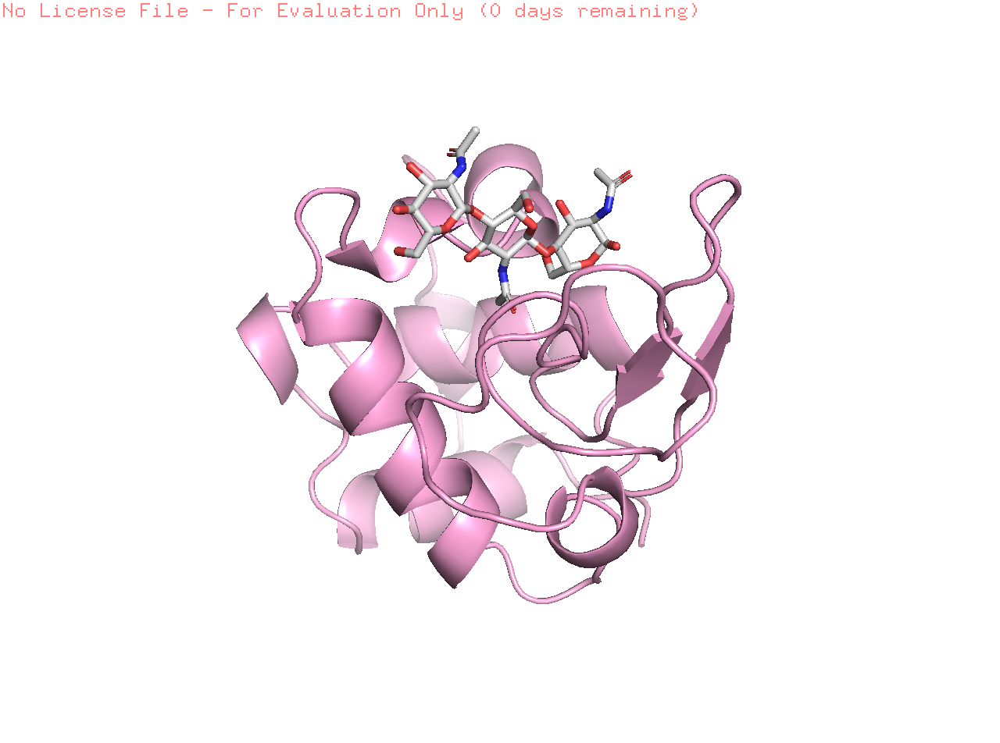

In [9]:
Image('/tmp/pymol_1lmp.png', width = 700)

##### Руками с помощью Wizard -> Sculpting (Command + click on macOS) изуродуем несчастный белок 

In [12]:
cmd.png('/tmp/protein_torture.png')

In [14]:
cmd.png('/tmp/protein_torture1.png') #другой ракурс того же самого 

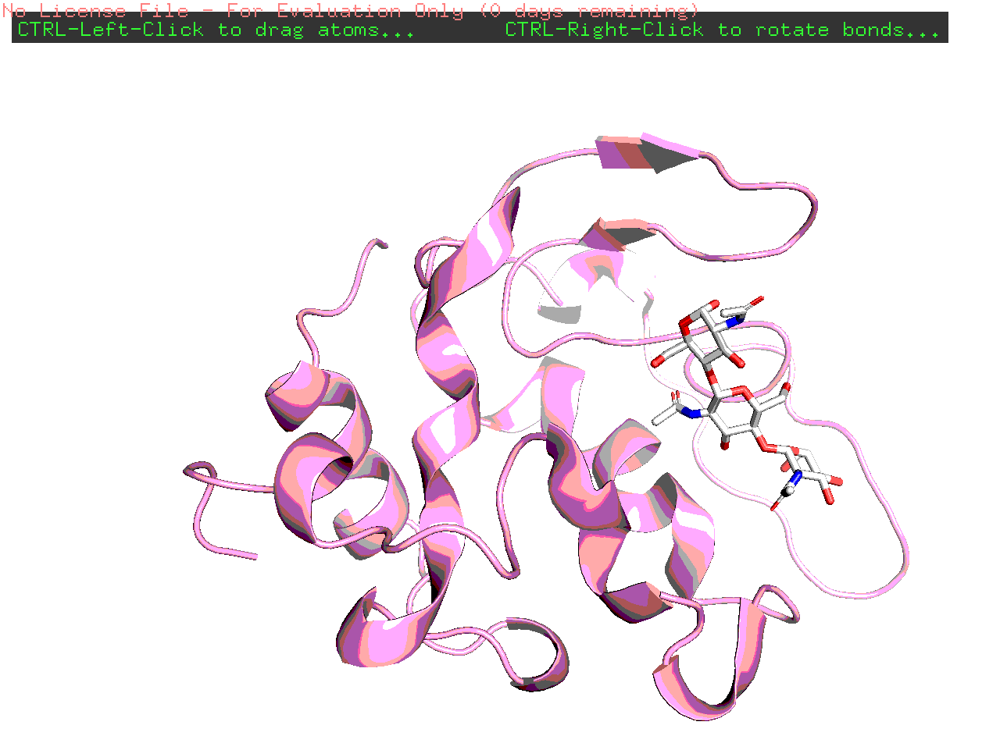

In [18]:
Image('/tmp/protein_torture.png', width = 700)

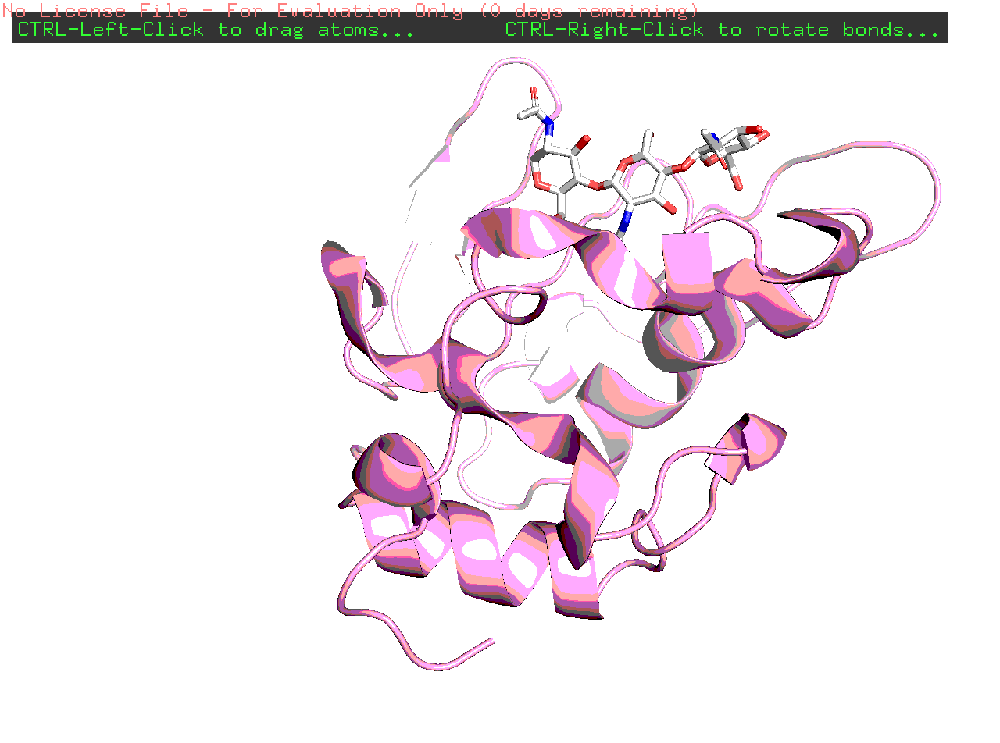

In [19]:
Image('/tmp/protein_torture1.png', width = 700)

##### Вернем несчастного в норму и оценим, какие остатки могут иметь принципиальное значение для связывания белка с лигандом 
### Для этого визуализируем поверхность контакта между белком и лигандом

In [36]:
cmd.reinitialize()

In [37]:
cmd.do('''
bg_color white
fetch 1lmp, async=0
zoom 1lmp
select ligand, hetatm
color pink
remove solvent
util.cbaw ligand''')

In [39]:
cmd.do('''
select contact_zone, ligand around 3.5
as lines, not ligand
show surface, contact_zone
distance h, ligand, contact_zone, 3.5, 2
orient ligand 
set label_font_id, 10
rotate x, 90
label contact_zone, "%s-%s" % (resn,resi) 
''')

In [43]:
cmd.set('ray_trace_mode', 1)
cmd.png('/tmp/1lmp_contact_zone.png')

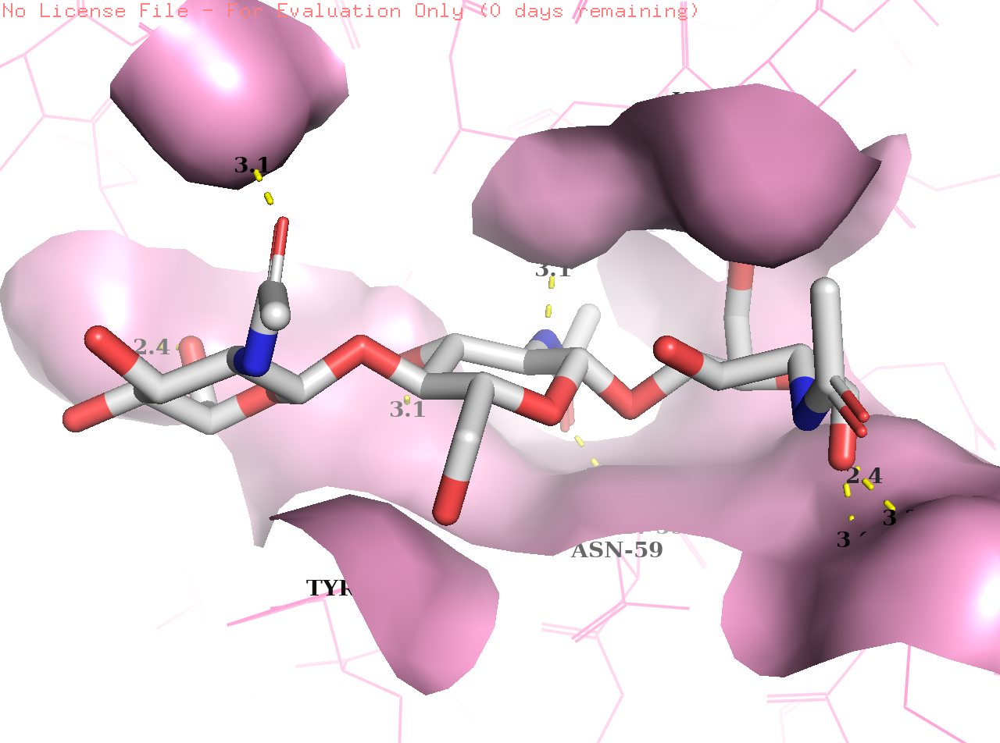

In [44]:
Image('/tmp/1lmp_contact_zone.png', width = 700)

##### Видим, что есть остаток ASP 52, расположенный от лиганда очень близко. Так как вероятно рядом стоящие остатки тоже вступают во взаимодействия с этим участком лиганда, по-видимому стабилизация этого фрагмента очень важна. Рассмотрим эту связь поближе

In [74]:
cmd.reinitialize()

In [75]:
cmd.do('''
bg_color white
fetch 1lmp, async=0
zoom 1lmp
select ligand, hetatm
color pink
remove solvent
util.cbaw ligand''')

In [76]:
cmd.do("""
select mutable, resi 52 
select contact_zone, ligand around 3.5
as lines, not ligand 
set_bond line_width, 7, mutable
distance h, ligand,  mutable, 3.5, 2
show sticks, mutable
color blue, mutable
label mutable, "%s-%s" % (resn,resi) 
orient ligand
""")

In [77]:
cmd.png('/tmp/1lmp_contact_zone.png')

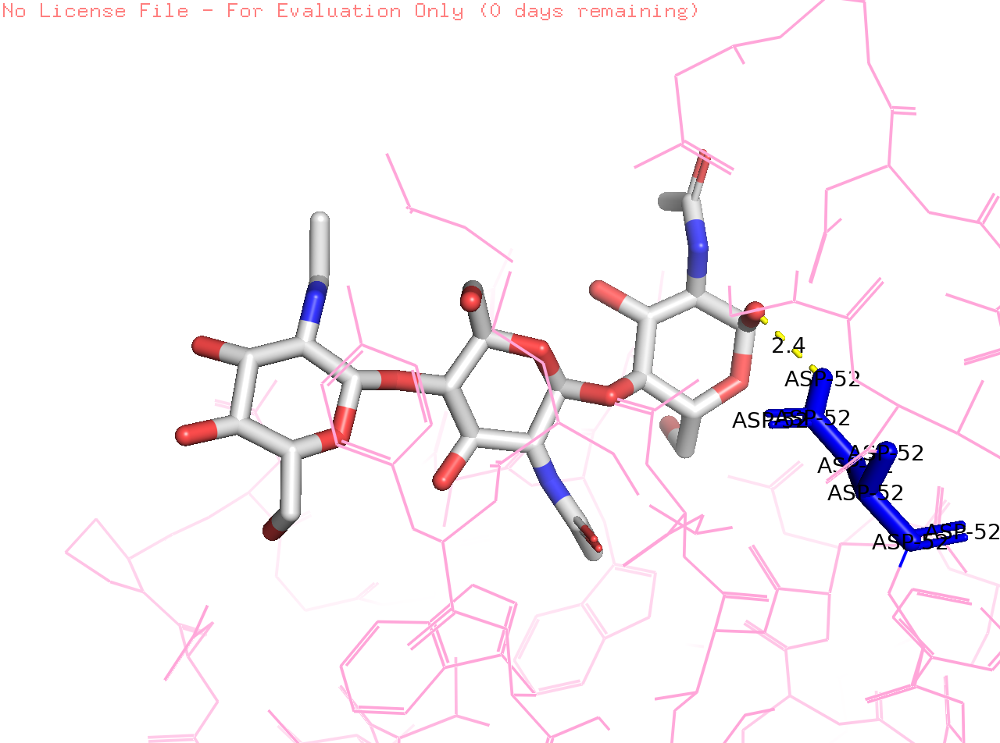

In [78]:
Image('/tmp/1lmp_contact_zone.png', width = 700)

##### Данные о важности этого остатка в функционировании лизоцима есть даже на соотвествующей страничке в вики. Заменим этот остаток на что-то визуально ощутимое, на триптофан к примеру 

In [20]:
cmd.reinitialize()

In [21]:
cmd.do('''
bg_color white
fetch 1lmp, async=0
zoom 1lmp
select ligand, hetatm
color pink
remove solvent
util.cbaw ligand''')

In [22]:
cmd.wizard('mutagenesis')
cmd.refresh_wizard()
cmd.do('''
wizard mutagenesis
refresh_wizard
python
cmd.get_wizard().do_select("resi 52")
cmd.get_wizard().set_mode("TRP")
cmd.get_wizard().apply()
cmd.set_wizard()
python end
''')

In [23]:
cmd.do('''
select mut, resi 52
util.cbao mut
hide cartoon, mut
show sticks, mut
zoom hetatm
''')

In [11]:
cmd.png('/tmp/mutation.png')

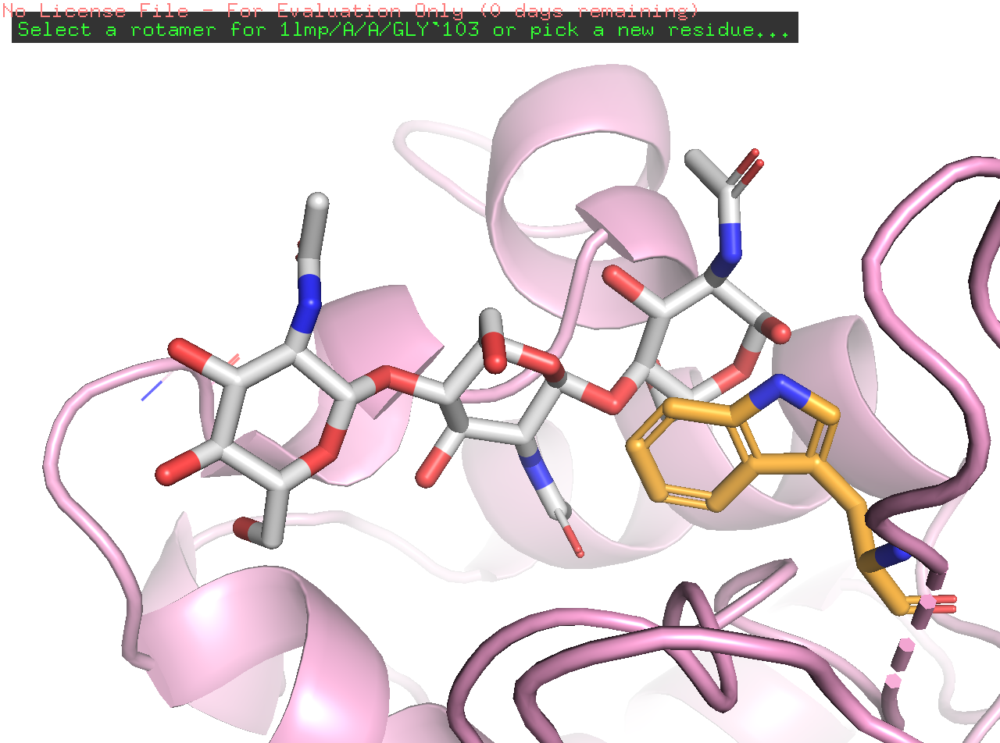

In [12]:
Image('/tmp/mutation.png', width = 700)

##### Итого, мы кинули на лиганд плотное кольцо, посмотрим, осталась ли связь

In [24]:
cmd.distance('hbond', '(/1lmp/A/A/TRP`52/CB)', 'hetatm', '3.5', '2') #не осталась, ура 

0.0

In [25]:
mutant = "resi 52"
cmd.fetch("1lmp", "native_protein")

'native_protein'

In [26]:
cmd.png('/tmp/changings.png')

##### А вот что поменялось от добавления остатка визуально

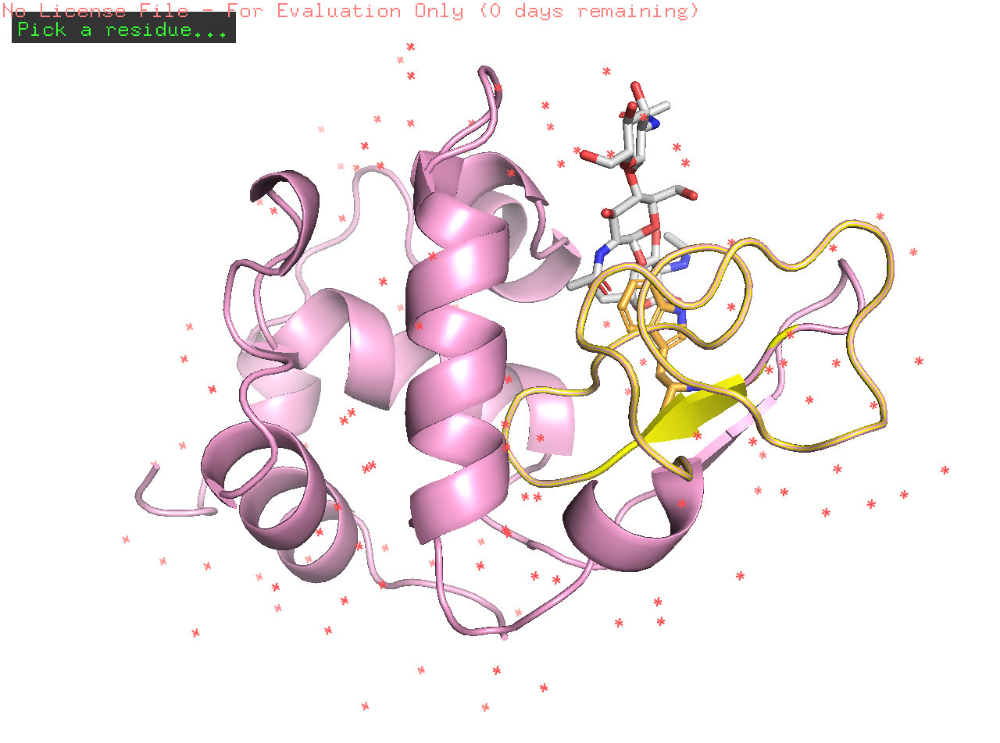

In [27]:
Image('/tmp/changings.png', width = 700)

#### Сделаем мультик с совмещением двух структур 

In [15]:
cmd.reinitialize()

In [16]:
cmd.do('''
bg_color white
fetch 1lmp, async=0
zoom 1lmp
select ligand, hetatm
color pink
remove solvent
util.cbaw ligand''') #все то же самое

In [55]:
cmd.wizard('mutagenesis')
cmd.refresh_wizard()
cmd.do('''
wizard mutagenesis
refresh_wizard
python
cmd.get_wizard().do_select("resi 52")
cmd.get_wizard().set_mode("TRP")
cmd.get_wizard().apply()
cmd.set_wizard()
python end
''') #все то же самое

In [56]:
cmd.do('''
fetch 1lmp, 1lmpnew
color blue, 1lmpnew
color pink, 1lmp
color red, resi 52 and 1lmpnew
color green, resi 52 and 1lmp
remove solvent
extract ligand,het
util.cbaw ligand
as cartoon, 1lmpnew
as cartoon, 1lmp
as sticks, ligand
show stick, resi 52
set stick_radius, 0.4, resi 52 and 1lmp
zoom all
center all
translate [30,0,0], object=1lmpnew 
''') #по-разному покрасим изначальную и новую структуры, разнесем их в пространстве

In [57]:
cmd.do('''
set matrix_mode, 1
set movie_panel, 1
set cache_frames, 1
mset 1-180


frame 1
mview store                     
mview store, object=1lmpnew         
mview store, object=1lmp

frame 50                        
translate [-30,0,0], object=1lmpnew 
mview store                     
mview store, object=1lmpnew         
mview store, object=1lmp        
mview interpolate, object=1lmpnew 

frame 100                      
center 1lmp
zoom 1lmp
mview store, object= object=1lmpnew 
mview store, object=1lmp    
mview interpolate, object=1lmpnew 

frame 130                      
orient resi 52 
mview store 
mview store, object=1lmpnew         
mview store, object=1lmp   

frame 160                       
orient resi 52                                      
mview store 
mview store, object=1lmpnew          
mview store, object=1lmp
mplay
''') #сделали фильмец с обратным движением вдоль оси x и зумом на несовпадающих остатках

In [58]:
! mkdir pymolmovie4

In [59]:
cmd.mpng('Documents/pymolmovie4/')

In [5]:
with imageio.get_writer('/tmp/movie.gif.png', format='gif', mode='I') as writer:
    for img in sorted(os.listdir('pymolmovie4/'))[::2]:
        filename = 'pymolmovie4/' + img
        image = imageio.imread(filename)
        writer.append_data(image)

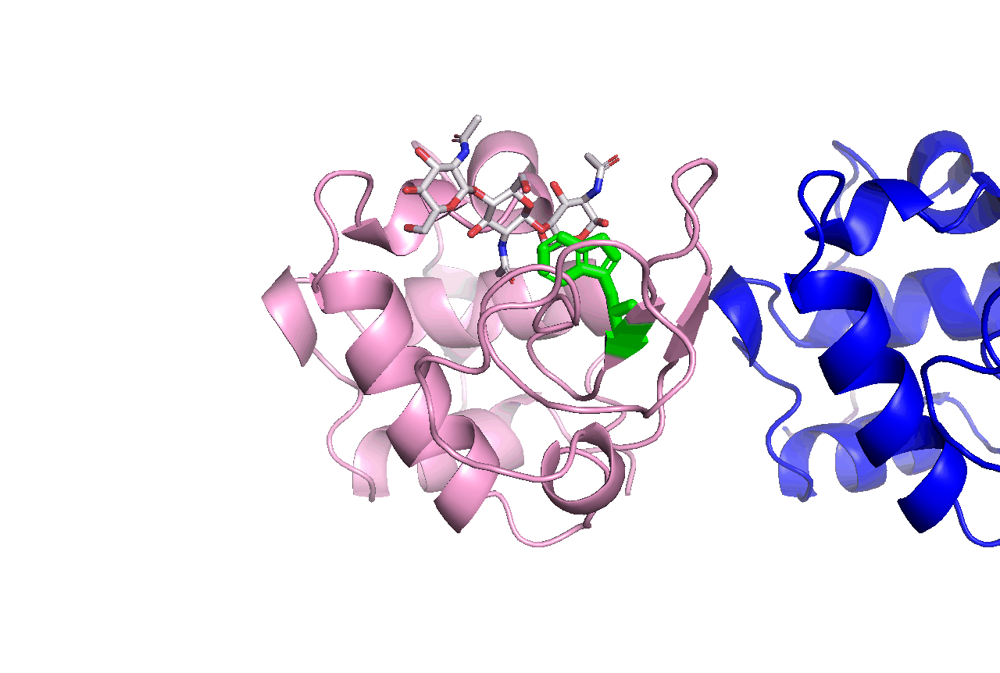

In [6]:
Image(filename='/tmp/movie.gif.png')

#### Припрепим к белку флуоресцентную метку

In [8]:
#скачаем струкутру метки TAMRA из pubchem 
file_name = 'tamra.sdf'
url = 'https://pubchem.ncbi.nlm.nih.gov/rest/pug/compound/cid/2762604/record/SDF/?response_type=save&record_type=3d'
urllib.request.urlretrieve(url, file_name)

('tamra.sdf', <http.client.HTTPMessage at 0x12d75abe0>)

In [ ]:
# для образования сложной диэфирной связи будем прикреплять метку к серину на поверхности белка (15)

In [33]:
cmd.do("""load tamra.sdf""")
cmd.turn('y', 180)

In [30]:
cmd.png('/tmp/tamra.png')

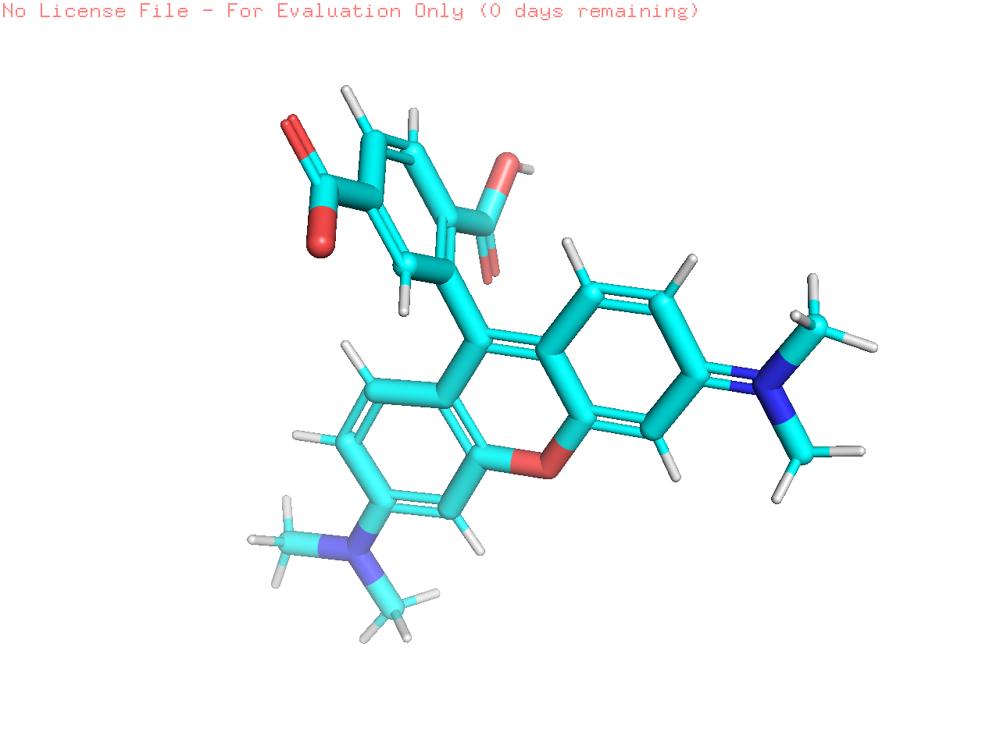

In [31]:
Image('/tmp/tamra.png', width = 700)

In [40]:
cmd.do('''
reini
bg_color white
fetch 1lmp, async=0
zoom 1lmp
select ligand, hetatm
color pink
remove solvent
util.cbaw ligand''')

In [41]:
cmd.select('resi 15')
cmd.remove('resi 122 and 1lmp and elem O and sidechain') #убираем кислород с серина для создания сложноэфирной связи
cmd.fuse('tamra and donor', 'resi 15 and name CB and 1lmp') 
cmd.remove('elem H') #уберем водород
cmd.delete('tamra')
cmd.do('zoom resi 15 and 1lmp, 2')

In [45]:
cmd.do("""
show sticks, resi 15
set_bond line_width, 7, resi 15
""")

In [46]:
cmd.png('/tmp/tamra_fusion.png')

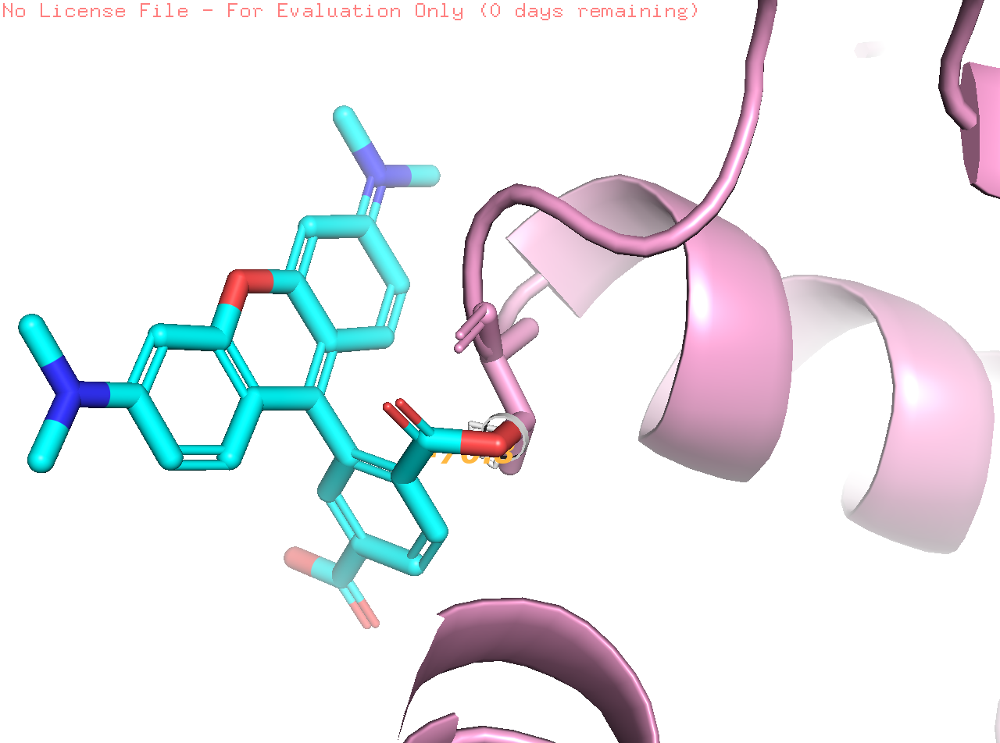

In [47]:
Image('/tmp/tamra_fusion.png', width = 700)

##### Получили фьюжн

### Сделаем  поли-аланиновую альфа-спираль из 100 ак

In [80]:
cmd.do('''
reini
fragment ala
bg_color white
as sticks, ala
util.cbaw ala
''')

##### Cоздали один аланин, а теперь собирем всю цепочку

In [81]:
cmd.do('''
python
for x in range(2,101):
     cmd.edit("/ala///"+str(x)+"/c")
     editor.attach_amino_acid("pk1","ala", ss=1)
python end
''')

In [82]:
cmd.do('''
center all
orient all
zoom all
''')

In [83]:
cmd.png('/tmp/alpha_ala1.png')

In [84]:
cmd.png('/tmp/alpha_ala.png')

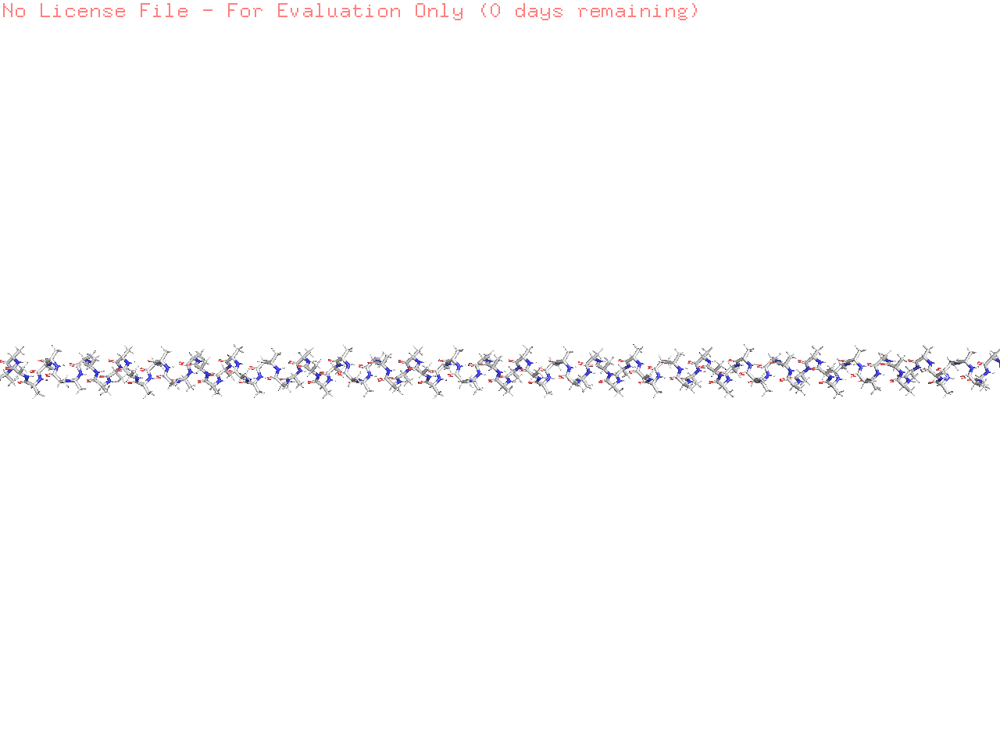

In [85]:
Image('/tmp/alpha_ala1.png')

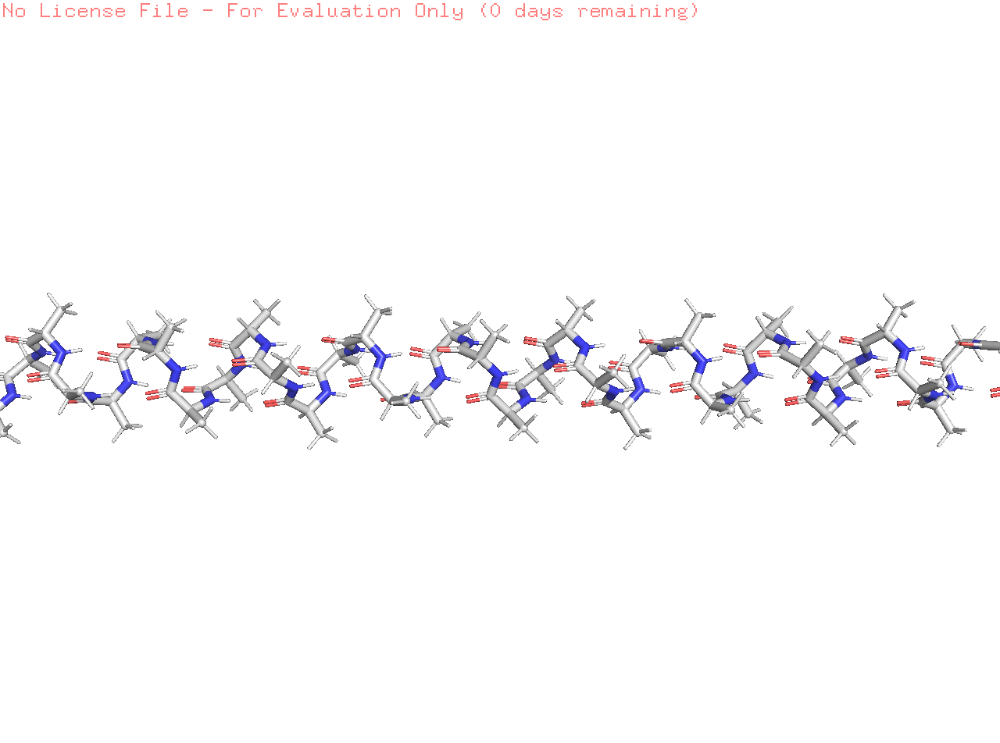

In [92]:
Image('/tmp/alpha_ala.png', width = 700)

In [87]:
cmd.turn('y', -90)
cmd.zoom("all", -50)

In [88]:
cmd.png('/tmp/alpha_ala_turn.png')

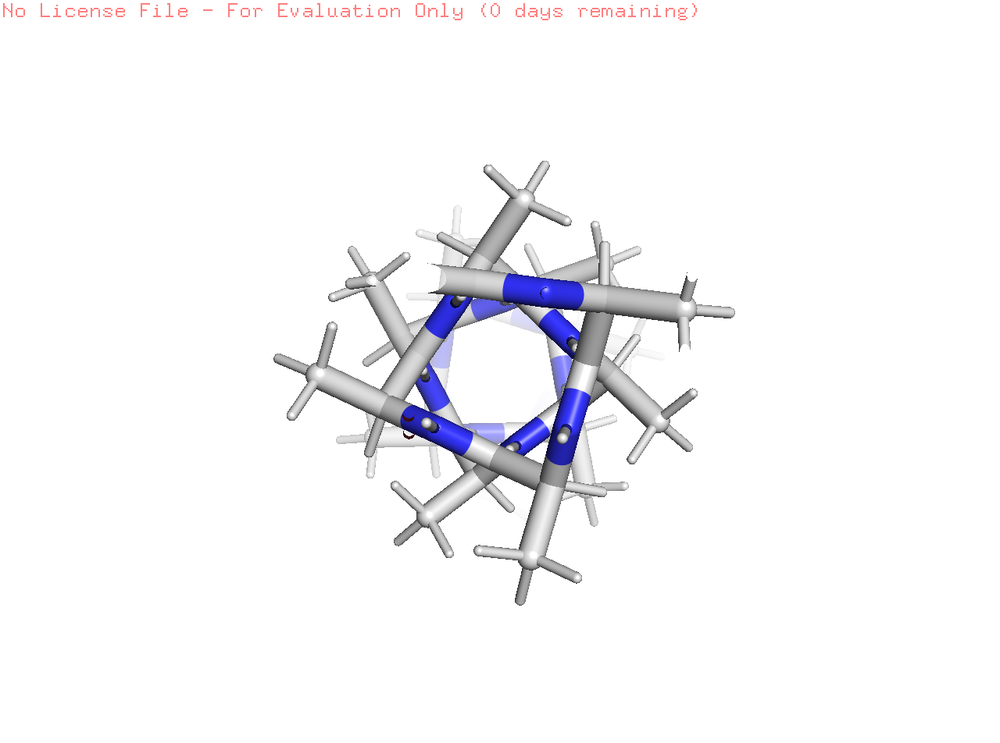

In [91]:
Image('/tmp/alpha_ala_turn.png', width = 400)

### Построим B-ДНК, за основу возьмем 1bna

In [117]:
cmd.do('''
reini
bg_color white
fetch 1bna
show sticks 
hide cartoon 
remove solvent
''') #загрузим структуру

In [118]:
cmd.create('0', 'chain A and resi 6 or chain B and resi 19') #возьмем для образца пары из серединки 
cmd.create('1', '0')
cmd.create('2', 'chain A and resi 7 or chain B and resi 18')

In [119]:
cmd.pair_fit('0', '2')  #сделаем матрицу перехода 
trans_matrix = cmd.get_object_matrix('0')
cmd.delete('0')

In [120]:
transformation = cmd.get_object_matrix("pair1") 
for x in range(2, 101):
    cmd.create(str(x), str(x-1))
    cmd.do('cmd.transform_selection(%i, %s, homogenous=0)' % (x, transformation))

In [121]:
for i in range(3, length + 1): #зададим остальные пары
    cmd.create(str(i), str(i - 1))
    cmd.transform_selection(str(i), trans_matrix)
for i in range(length):
    cmd.alter(str(i + 1), f'resi={i + 1}')

In [122]:
cmd.delete('355d') #удалим старую структуру 

In [123]:
cmd.do('''
center all
orient all
zoom all
''')
cmd.png('/tmp/dna.png')

In [124]:
cmd.png('/tmp/dna1.png')

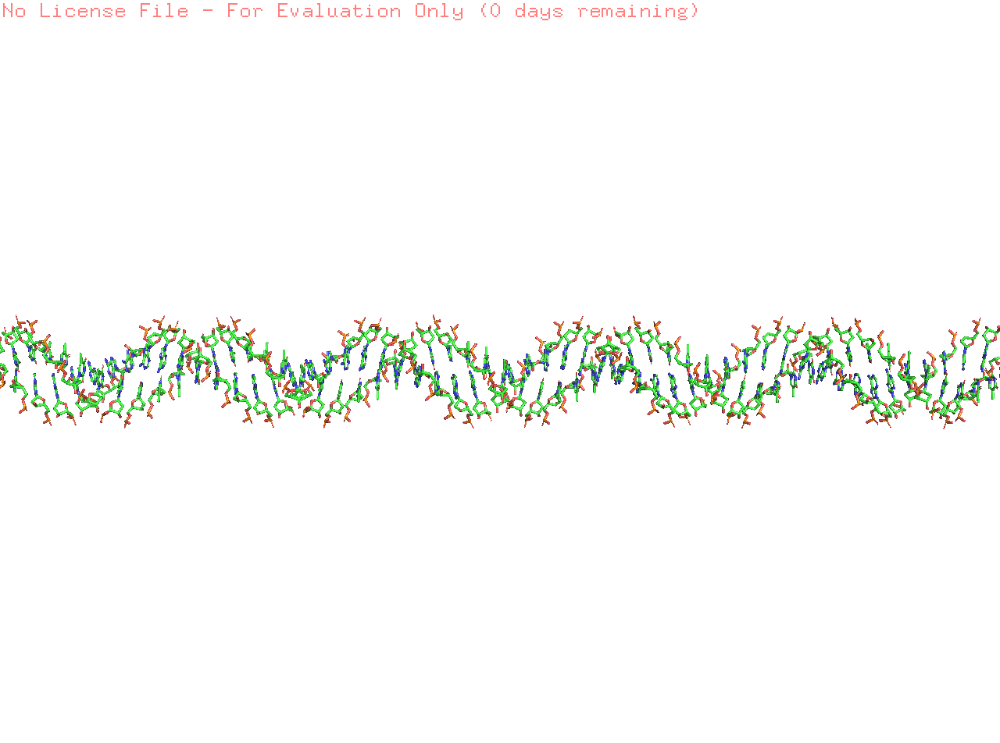

In [128]:
Image('/tmp/dna1.png')

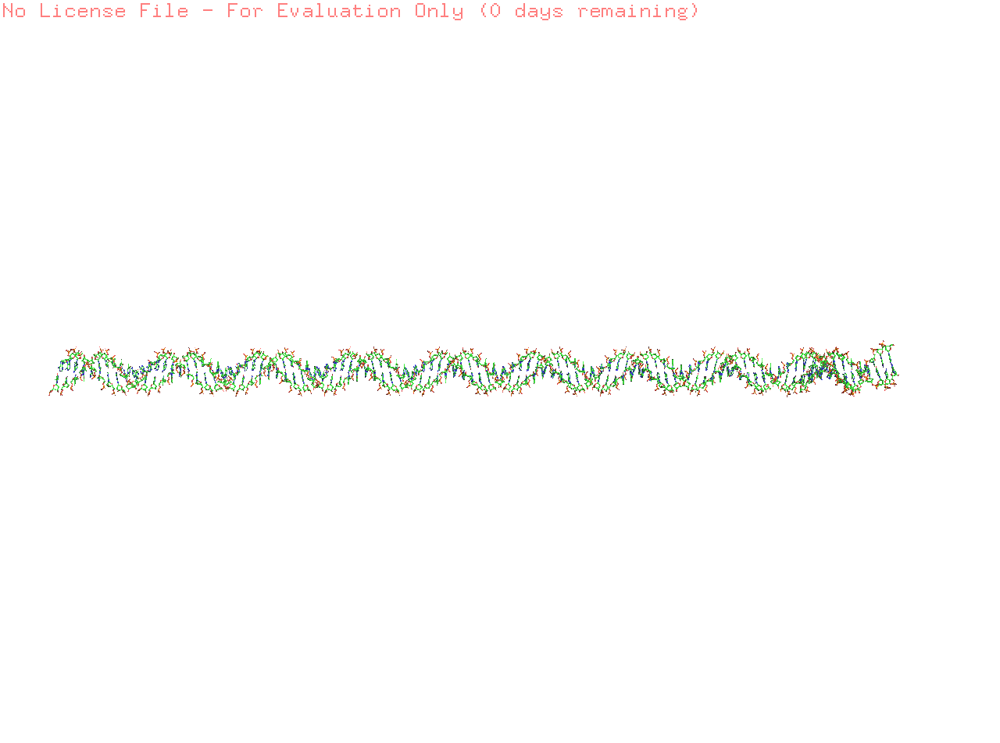

In [127]:
Image('/tmp/dna.png')